## 本日の資料

::: {style="font-size: 2em;"}
[https://github.com/tesshy/TRONSHOW2024](https://github.com/tesshy/TRONSHOW2024)
:::

- 本日の発表内容は2024-09-19に開催された、odpt開発者向けWebinarの内容を増強したものになります
    - SQLの見直し、前回無かったデータの味見、ずっとスッキリしてなかったGTFS-RTの取り扱い方法、etc...
    - 今回は時間内に収まるようにします・・・

## About tesshy

**渡邊徹志（1984年生まれ・TRONと同い年、栃木県出身）**
```
2009-04 - 2015-03: 東京大学大学院学際情報学府学際情報学専攻総合分析情報学コース博士後期課程坂村・越塚研究室（単位取得満期退学）
2012-04 - 2018-07: YRPユビキタス・ネットワーキング研究所研究員
2018-07 - 2019-02: 無職
2019-02 - 2024-01: 株式会社MaaS Tech Japan CTO
2024-02 - 2024-03: 無職
2024-04 - 2024-03: 株式会社team-7、複数社お手伝い、農業（主にデジタル化、運転手として）
```

- 学士、修士は共に無線通信によるロケーションシステムの研究、以降は画像認識、AR、救急医療システム、オープンデータ、公共交通データ、etc
    - odptの最初期の仕様策定と実装は自分が担当してました、<br />もう10年ぐらい前・・・
- 最近はデータ基盤設計、データ分析、プロマネ、コンサルティング、etc
- 農作業を手伝い、バスの中で仕事してる（大型・けん引免許所持）

---

:::: {.columns}

::: {.column width="40%"}
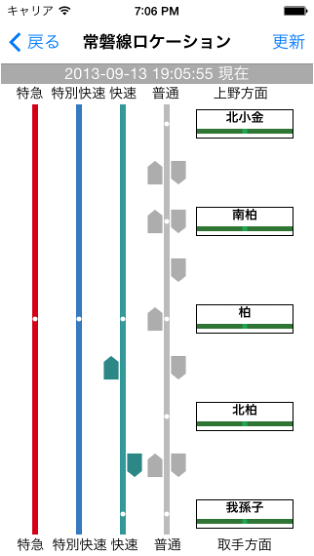
:::

::: {.column width="60%"}
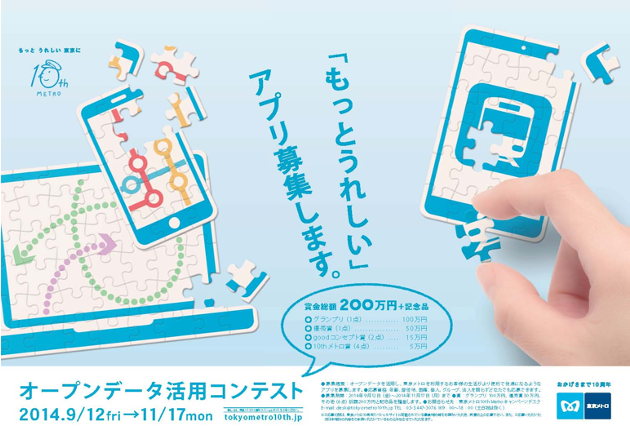{width=500}

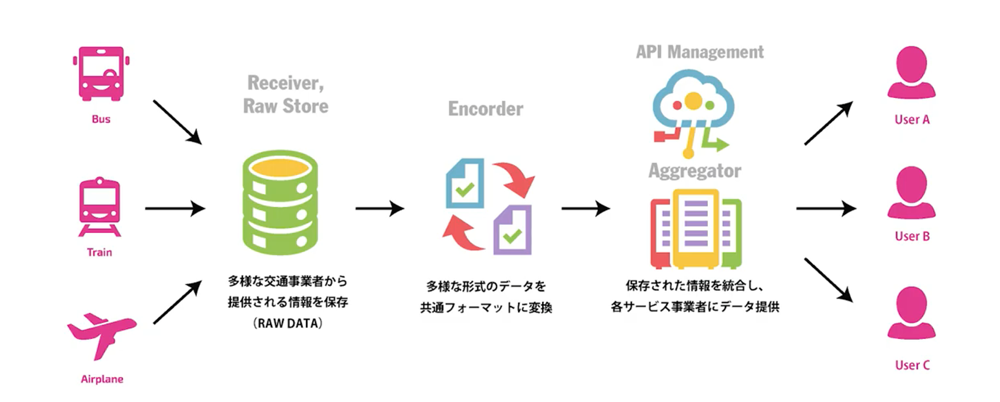{width=500}
:::

::::


---

:::: {.columns}
::: {.column width="60%"}
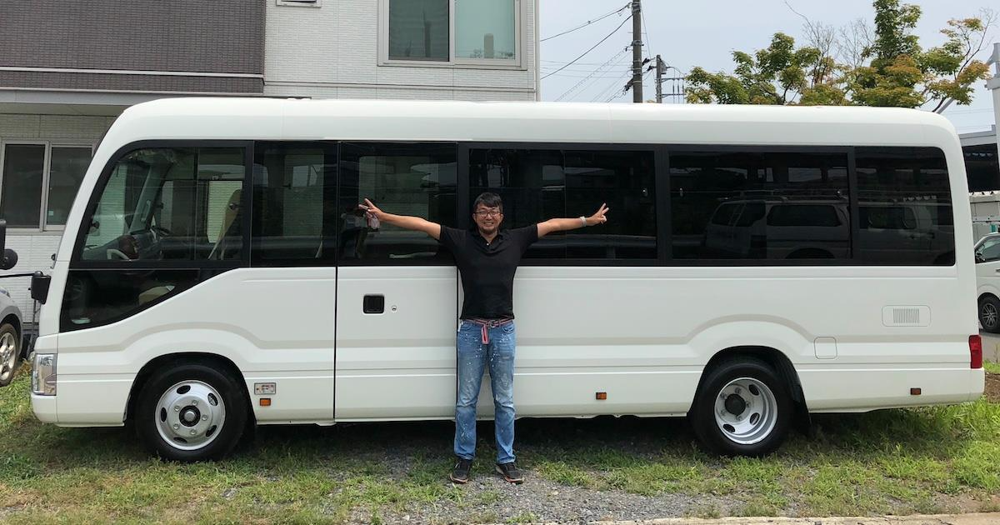
:::
::: {.column width="40%"}
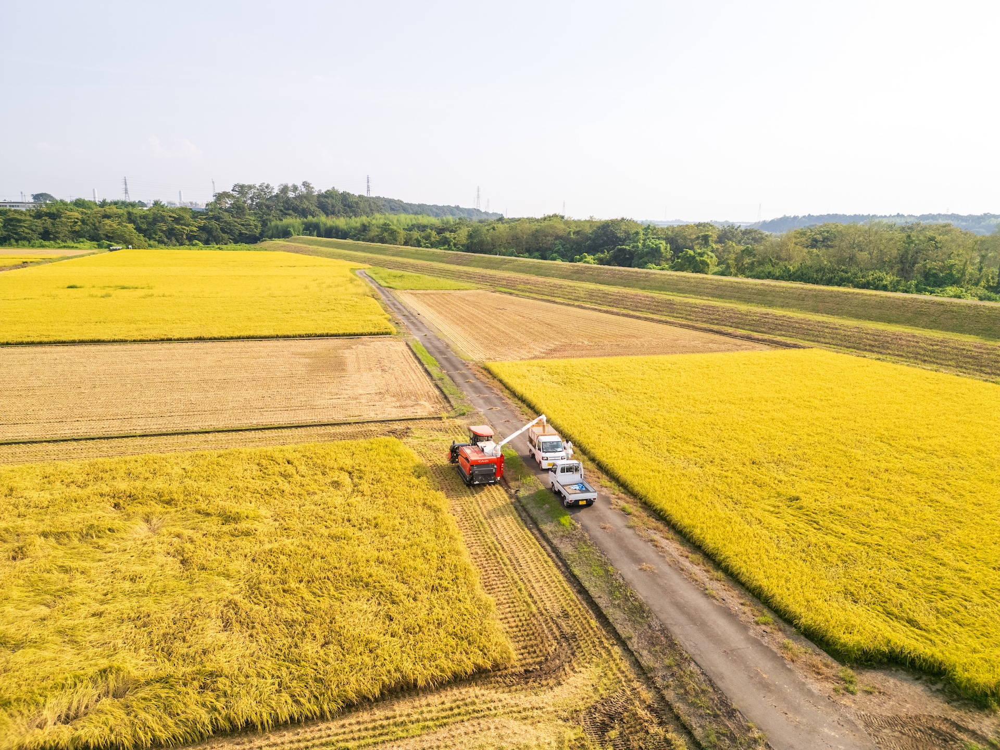
:::
::::


## About tesshy

**渡邊徹志（1984年生まれ・TRONと同い年、栃木県出身）**
```
2009-04 - 2015-03: 東京大学大学院学際情報学府学際情報学専攻総合分析情報学コース博士後期課程坂村・越塚研究室（単位取得満期退学）
2012-04 - 2018-07: YRPユビキタス・ネットワーキング研究所研究員
2018-07 - 2019-02: 無職
2019-02 - 2024-01: 株式会社MaaS Tech Japan CTO
2024-02 - 2024-03: 無職
2024-04 - 2024-03: 株式会社team-7、複数社お手伝い、農業（主にデジタル化、運転手として）
```

- 学士、修士は共に無線通信によるロケーションシステムの研究、以降は画像認識、AR、救急医療システム、オープンデータ、公共交通データ、etc
    - odptの最初期の仕様策定と実装は自分が担当してました、<br />もう10年ぐらい前・・・
- 最近はデータ基盤設計、データ分析、プロマネ、コンサルティング、etc
- 農作業を手伝い、バスの中で仕事してる（大型・けん引免許所持）

---

:::: {.columns}

::: {.column width="40%"}
![柏市公共交通情報連携アプリ(2013年)](attachment:image-2.png)
:::

::: {.column width="60%"}
![東京メトロオープンデータコンテスト(2014年)](attachment:image-3.png){width=500}

![TraISARE(2022年)](attachment:image-4.png){width=500}
:::

::::


---

:::: {.columns}
::: {.column width="60%"}
![愛車と共に](attachment:image.png)
:::
::: {.column width="40%"}
![農業](attachment:image-5.png)
:::
::::


## 目的

公共交通データのオープン化が進み、従来では実現が難しかった様々な応用が実現され始めている。
本セミナーではGTFS・GTFS-RTデータの基礎とその取り扱い方を解説し、
DuckDBを用いた簡易的なELT環境の構築とクエリ・変換処理、可視化の手段を説明する。
発展的に、異なるデータとの組み合わせ方、インサイトの求め方を説明する。

- 公共交通データをどうやって扱うか
    - 可視化を例に
- データ処理の基本を知る: ETL・ELTの初歩
    - 公共交通に限らず、幅広いデータを扱えるように
- どんなツールがあるのか・使えるのか
    - 渡邊が使っているツール類を紹介

## 公共交通データを使いたい！

- 乗換案内アプリを作りたい
- バスの遅延情報を提供したい
- 公共交通を用いた到達圏の分析をしたい

::: {#tip-example .callout-tip}
## よくある話
「何を実現したい」から「何が必要か」を考えましょう。手段が目的とならないように・・・。
:::

## GTFSを可視化してみる

- データを扱う上で必要なことは、まず**可視化**
    - どんなデータなのか
    - 何に使えそうか
    - どうやって処理（加工）するか
    - ~~データが間違ってないか~~
- データの民主化（Data Democratization）への第一歩
    - 従来一部の専門家だけが扱っていたものを、広く使えるように
    - 公開されるだけではなく、如何に使われるか
- 今回は**GTFS**を可視化してみる
    - GTFSの構造理解も兼ねて、プリミティブな方法を使ってみる
- **使うツールはDuckDB(SQL)とKepler.glだけ**
    - データ処理だけに全集中

## GTFS可視化レシピ

1. [GTFS](https://gtfs.org)をダウンロードする（ここでは[都営バス](https://api-public.odpt.org/api/v4/files/Toei/data/ToeiBus-GTFS.zip)を対象にする）
    - GTFSの仕様は現在[MobilityData](https://mobilitydata.org)が管理
2. [DuckDB](https://duckdb.org)にGTFSを読み込む
    - DuckDBはOLAP: Online Analytical Processingに強いDB
    - 1ファイルにデータをまとめられるので便利
    - Excelで扱いきれないような膨大なデータでも処理できる<br />（数十GBぐらいのデータなら一般的なスペックで処理可能）
3. [Kepler.gl](https://kepler.gl/)で可視化する
    - GISデータをWebブラウザ上で可視化できるツール、OSSであればこれが一番軽量で使いやすい（渡邊調べ）
    - 結果を1つのHTMLファイルとして出力できるので、ネットワークセキュリティの厳しい環境でも使える（重要）

## ETLとELT: 似てるようで違う

- ETL: Extract, Transform, Load: データを取り出す、加工する、保存する。一般的なデータウェアハウスのパイプライン
- ELT: Extract, Load, Transform: データを取り出す、保存する、加工する。DBに一旦全てのデータを保存してから加工する

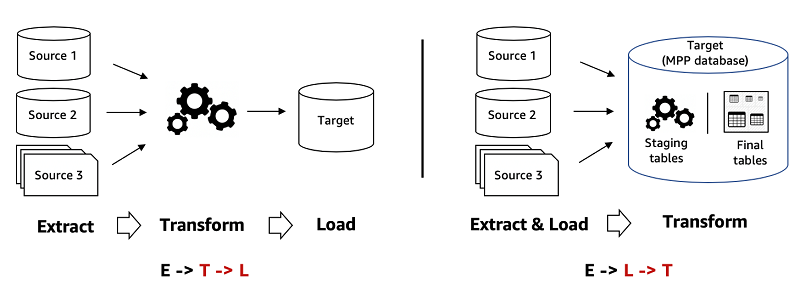

[https://aws.amazon.com/jp/compare/the-difference-between-etl-and-elt/](https://aws.amazon.com/jp/compare/the-difference-between-etl-and-elt/)

---

- 大規模なDWH: Data Ware HouseではETLが一般的
- 中小規模であればETLで十分、というかむしろイイと思い始めた: DuckDBの出現
- Data Lakeはどちらにしろ必須: データをとりあえず溜めておく場所: S3、ADLS、GCSが一般的
- 最近はData Lake Houseという概念もある: DWHとDataLakeを組み合わせたもの、[Databricks](https://www.databricks.com/jp/glossary/data-lakehouse)が提唱

- DuckDBで事足りなくなったら、DatabricksのようなData Lake Houseサービスへ
    - 企業内で統一したデータ基盤を整備するなど、メタデータ管理が必要になったら入れる必要があると考えている

::: {#tip-example .callout-tip}
## よくある話
正直分析要件は刻々と変化する（≒最初から決まってることなんてない）ので、データ基盤として如何にアジリティが高い環境を準備できるかが勝負どころ
:::

## DuckDBについて

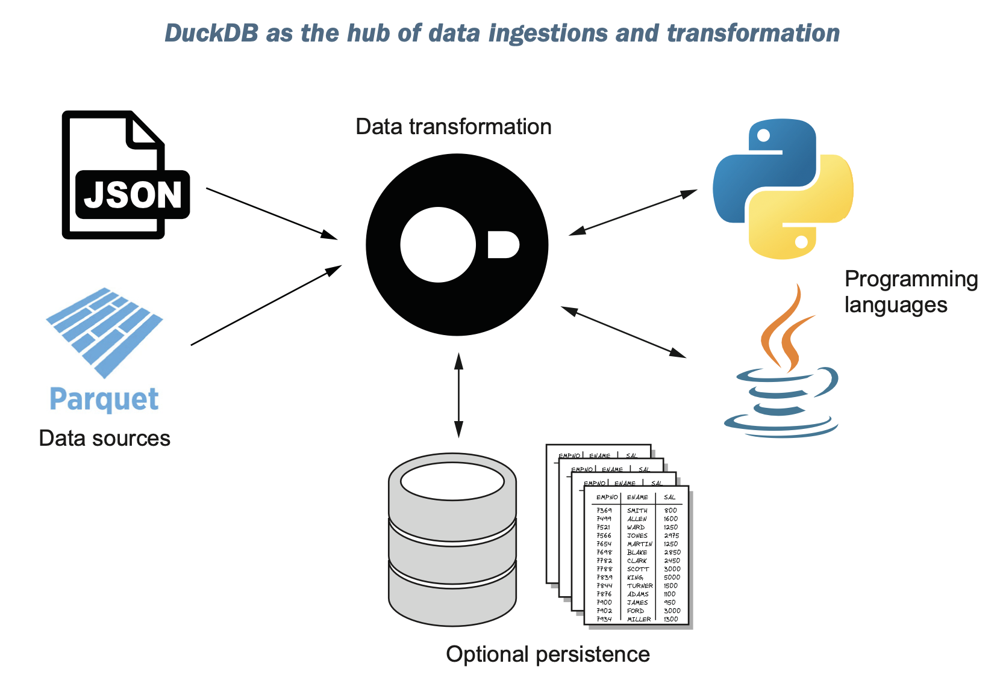

Needham, M., Hunger, M., Simons, M. (2024). [DuckDB in Action](https://motherduck.com/duckdb-book-brief/). Manning Publications.

---

- **構造データをサクッといい感じに扱えるツール**
- 組み込み型DB、SQLiteのOLAP版と言われることもある
    - OLAP: Online Analytical Processing (大規模データ分析向け)
    - 列指向型DB（Columnar DB）であるため、データの圧縮効率が高い
        - 同じ列には同じ型で同じようなデータが入るため
- GISデータ（GeoJSON、Shapefile、etc）も読み込めて簡易なGIS演算もできる
    - **公共交通データを扱う際に超重要**
- 読み込んだデータをSQLで処理（変換・整形）できる
    - 標準SQLはほぼサポートされている
- [dbt](https://www.getdbt.com)や[dlt](https://dlthub.com)と組み合わせて使うとETL（Extract, Transform, Load）環境が作れる
    - DuckDB単体でもELT的なことはできるが、更新系の管理や変換ルールを管理するために使う

## DuckDBのインストール

[https://duckdb.org/docs/installation](https://duckdb.org/docs/installation)

- Windows: `winget install DuckDB.cli`
    - WSLの場合はLinuxの手順を使う
- macOS: `brew install duckdb`
    - [Homebrew](https://brew.sh/ja/)  をインストールしてから実行
- Linux: [https://github.com/duckdb/duckdb/releases/download/v1.1.3/duckdb_cli-linux-amd64.zip](https://github.com/duckdb/duckdb/releases/download/v1.1.3/duckdb_cli-linux-amd64.zip)
    - ダウンロードして解凍できるバイナリを使う


## Kepler.glについて

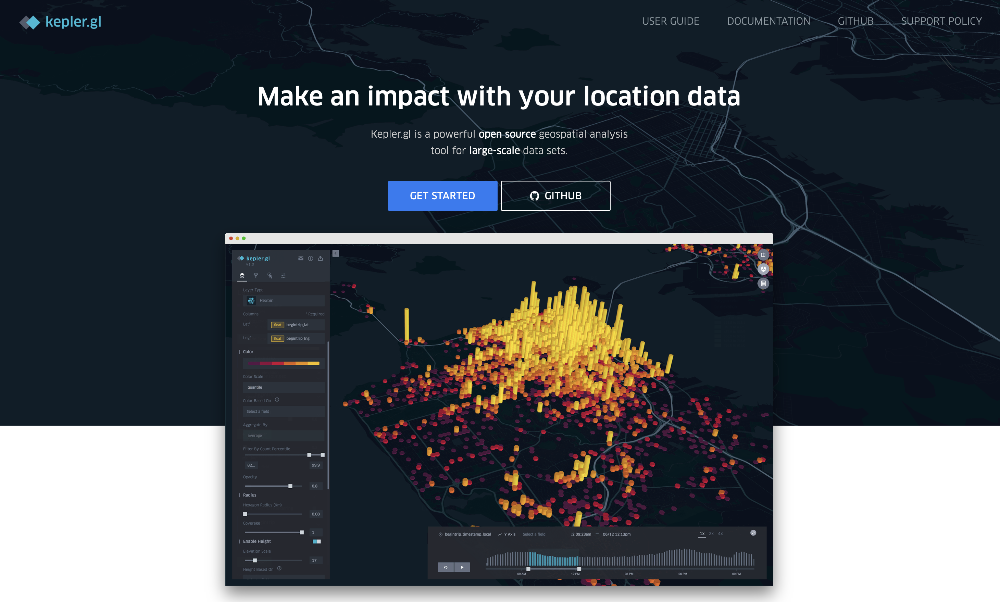

---

- **Webブラウザ上でGISデータをいい感じに可視化できるツール**
- Uberが開発したツールがOSS化されたもの
    - [deck.gl](https://deck.gl/)をベースに構築されている
- 地理情報を含んだCSVやGeoJSONを読み込んで可視化できる
    - サーバーに情報が送られるのではなく、ブラウザの中で処理されて表示される
- レイヤーを重ねて可視化できる
    - e.g. バス停勢圏のレイヤーに、夜間人口のレイヤーを重ねる
- [Forsquare Studio](https://studio.foursquare.com)という高機能なプロプライエタリ版がある
    - 元はUnfoldedというスタートアップが開発していたものをForsquareが買収
    - Forsquare StudioはDBに直接接続してデータを取得できるなどの拡張があるため、必要に応じてこちらを使用することも推奨
    - （最近OSSであるKepler.gl側のメンテナンスが滞っている印象がある為、たまにDemoが動かないことがある・・・）

# DuckDBにGTFSを読み込む

## GTFSをダウンロードする

- [都営バスのGTFS](https://api-public.odpt.org/api/v4/files/Toei/data/ToeiBus-GTFS.zip)をダウンロード
```bash
curl -L -o ToeiBus-GTFS.zip https://api-public.odpt.org/api/v4/files/Toei/data/ToeiBus-GTFS.zip
```

- ダウンロードしたGTFSを解凍
```bash
unzip ToeiBus-GTFS.zip
```

- GTFSのファイル構造を眺めてみる
```bash
# ls -1
ToeiBus-GTFS.zip
agency.txt: 運行会社情報
agency_jp.txt
attributions.txt
calendar.txt: 運行日情報
calendar_dates.txt: 運行日付情報
fare_attributes.txt: 運賃情報
fare_rules.txt: 運賃ルール情報
feed_info.txt: フィード情報
office_jp.txt
routes.txt: 路線情報
shapes.txt: 路線形状情報
stop_times.txt: 時刻表情報
stops.txt: 停留所情報
translations.txt
trips.txt: 便情報
```

## GTFSをDuckDBに読み込む
- DuckDBを起動する
```bash
$ duckdb ViewGTFS.duckdb

v1.0.0 1f98600c2c
Enter ".help" for usage hints.
D 
```

- Spartial Spartial Extensionを有効にする（2回目以降はLOAD spatialのみで使える）
```sql
INSTALL spatial;
LOAD spatial;
```


- stops.txt、shapes.txt, trips.txtを直接クエリし、その結果をテーブルとして保存
```sql
-- stops.csvをstopsテーブルに保存する
CREATE OR REPLACE TABLE stops AS SELECT * FROM read_csv('stops.txt');
CREATE OR REPLACE TABLE shapes AS SELECT * FROM read_csv('shapes.txt');
CREATE OR REPLACE TABLE trips AS SELECT * FROM read_csv('trips.txt');

```

- 作成したテーブルを確認してみる
```sql
SELECT * FROM stops LIMIT 5;
```
---

## 例外: stop_times.txtの対応

- 殆どはスキーマ自動推論に任せれば大丈夫だが、stop_times.txtだけ時刻が25:00:00などの日付を超えた表記方法が出現しtime型で読み込もうとして失敗するので、Schema（Columns）指定する
```sql
CREATE OR REPLACE TABLE stop_times AS SELECT * FROM read_csv(
    'stop_times.txt', 
    header=true, 
    columns={ 
        'trip_id': 'VARCHAR', 
        'arrival_time': 'VARCHAR', 
        'departure_time': 'VARCHAR', 
        'stop_id': 'VARCHAR', 
        'stop_sequence': 'INTEGER', 
        'stop_headsign': 'VARCHAR', 
        'pickup_type': 'UTINYINT', 
        'drop_off_type': 'UTINYINT', 
        'shape_dist_traveled': 'DOUBLE', 
        'timepoint': 'UTINYINT' 
});
```

## 蛇足: GTFS2DuckDBスクリプト

- ちょっとパワーアップして、複数のGTFSを一つのDBにまとめるようにした（スキーマで分割）

```bash
# Usage: bash GTFS2DuckDB.sh DB_NAME GTFS_URL GTFS_TITLE
#bash ./GTFS2DuckDB.bash gtfs https://api-public.odpt.org/api/v4/files/Toei/data/ToeiBus-GTFS.zip toeibus
#bash ./GTFS2DuckDB.bash gtfs https://api-public.odpt.org/api/v4/files/JR-Freight/data/JR-Freight-Train-GTFS-250.zip jrf

DBNAME=$1
GTFS_URL=$2
TITLE=$3
GTFS_FILE=${GTFS_URL##*/}

echo "Download: $GTFS_FILE"
curl -L -o $TITLE.zip $GTFS_URL
echo "Import: $GTFS_FILE to $TITLE.duckdb"
duckdb $DBNAME.duckdb -c "CREATE SCHEMA IF NOT EXISTS $TITLE"

for basename in `unzip -Z1 $TITLE.zip`; do
    filename=${basename%.*}
    echo "${filename} to DuckDB"
    # stop_timesのみスキーマ自動判定が失敗するので、手動でスキーマ定義を渡す（arrival_time, departure_timeが25:00:00のような24時越えの値を含むため）
    if [ $filename = "stop_times" ]; then
        unzip -p $TITLE.zip $basename | duckdb $DBNAME.duckdb -c "CREATE OR REPLACE TABLE $TITLE.${filename} AS SELECT * FROM read_csv('/dev/stdin', header=true, columns={ 'trip_id': 'VARCHAR', 'arrival_time': 'VARCHAR', 'departure_time': 'VARCHAR', 'stop_id': 'VARCHAR', 'stop_sequence': 'INTEGER', 'stop_headsign': 'VARCHAR', 'pickup_type': 'UTINYINT', 'drop_off_type': 'UTINYINT', 'shape_dist_traveled': 'DOUBLE', 'timepoint': 'UTINYINT' })"
    else
        unzip -p $TITLE.zip $basename | duckdb $DBNAME.duckdb -c "CREATE OR REPLACE TABLE $TITLE.${filename} AS SELECT * FROM read_csv('/dev/stdin')"
    fi
done
```

# DuckDBにGTFS-RTを読み込む

## GTFS-RTと取り扱い方法

GTFS-RTとは

> GTFS realtimeフィードを使用すると、交通事業者は、サービスへの混乱 (駅の閉鎖、路線の運行停止、重大な遅延など)、車両の位置、到着予定時刻に関するリアルタイム情報を消費者に提供できます。[https://gtfs.org/ja/documentation/realtime/reference/](https://gtfs.org/ja/documentation/realtime/reference/)

ProtocolBufferによるバイナリ形式で提供される

> プロトコル バッファーは、構造化データをシリアル化するための Google の言語中立、プラットフォーム中立の拡張可能なメカニズムです。XML を思い浮かべてください。ただし、より小さく、より速く、よりシンプルです。データをどのように構造化するかを一度定義すると、特別に生成されたソース コードを使用して、さまざまな言語を使用して、さまざまなデータ ストリームとの間で構造化データを簡単に読み書きできるようになります。
[https://protobuf.dev/](https://protobuf.dev/)

---

- DuckDBでProtocolBufferを直接インポートすることはできない
    - 厳密にはUnOfficialなプラグインがあるが、なんか上手くいかなかった
- GTFS-RTを直接DuckDBに保存するPythonスクリプトを書いた
    - JSONLで出力するようにしてstdio経由でDuckDBに読み込むのもいいかも

```python
import duckdb
import pandas as pd
from google.transit import gtfs_realtime_pb2
from google.protobuf import json_format
import requests

# %% GTFS-RTを取得してパースする
feed = gtfs_realtime_pb2.FeedMessage()
response = requests.get('https://api-public.odpt.org/api/v4/gtfs/realtime/ToeiBus')
feed.ParseFromString(response.content)
# %% パースしたデータをPython Dictにした上でDataFrameに変換
f = json_format.MessageToDict(feed)
# pd.json_normalizeでentityに含まれるデータのKeyをFlattingした上でDataFrameに変換
df_feed = pd.json_normalize(f["entity"])
# vehicle.timestampをUnixTimeからDateTimeに変換、この際UTCとして扱うようにしておくことで日本時間で扱いやすくなる
df_feed['vehicle.timestamp'] = pd.to_datetime(df_feed['vehicle.timestamp'], unit='s', utc=True)
# %% DuckDBに保存（MotherDuckに保存する場合はmd:gtfsrt?motherduck_token=MD_TOKEN）
con = duckdb.connect("gtfsrt.duckdb")
# 初回だけこちらを実行してください
con.execute("CREATE SCHEMA IF NOT EXISTS toeibus")
con.execute("CREATE TABLE IF NOT EXISTS toeibus.vehicles AS SELECT * FROM df_feed")
# 2回目以降はこちら
con.execute("INSERT INTO toeibus.vehicles SELECT * FROM df_feed")
con.close()
```

# Kepler.glで可視化する

## DuckDBでGTFSをKepler.glで可視化できるデータに変換する

```sql
-- 出力するデータのスキーマを選択
USE toeibus;

-- stopsをCSVで出力する
COPY (
    SELECT * FROM stops
) TO 'stops.csv' WITH (FORMAT CSV, HEADER);

-- TripsをShapesから得られたLineStringのGeoJSONで出力する
COPY (
    SELECT * FROM trips
    LEFT JOIN (
        SELECT 
            shape_id,
            {
                "type": 'LineString',
                "coordinates": list([shape_pt_lon,shape_pt_lat] ORDER BY shape_pt_sequence ASC)
            }::JSON AS "geometry" 
        FROM shapes GROUP BY shape_id
    ) AS shapes ON trips.shape_id = shapes.shape_id
) TO 'trips.csv' WITH (FORMAT CSV, HEADER);
```

---

[https://kepler.gl/demo](https://kepler.gl/demo)を開いて、出力された ToeiBus-GTFS_stops.csv と ToeiBus-GTFS_trips.csv をD&Dする
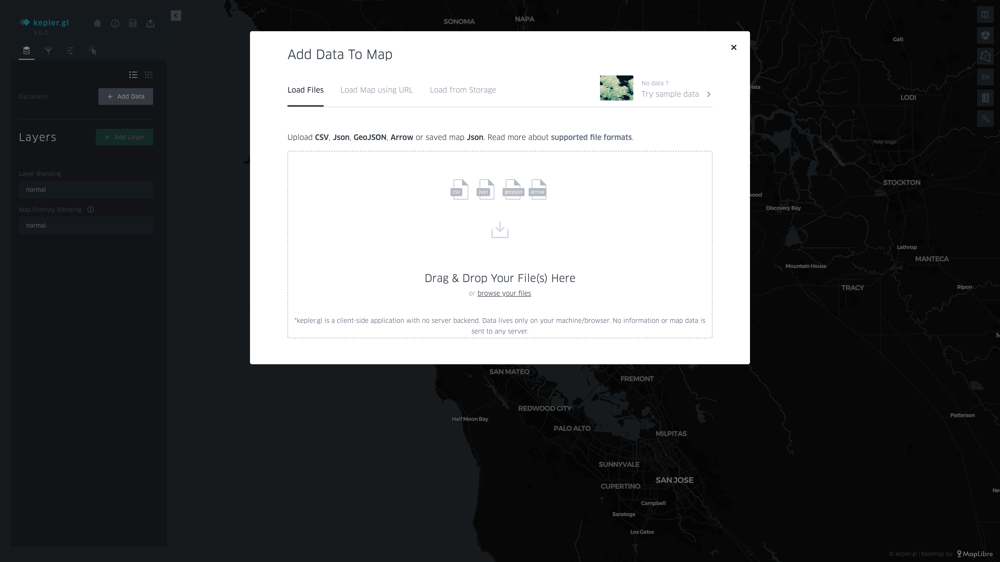

---

停留所と路線形状が可視化される
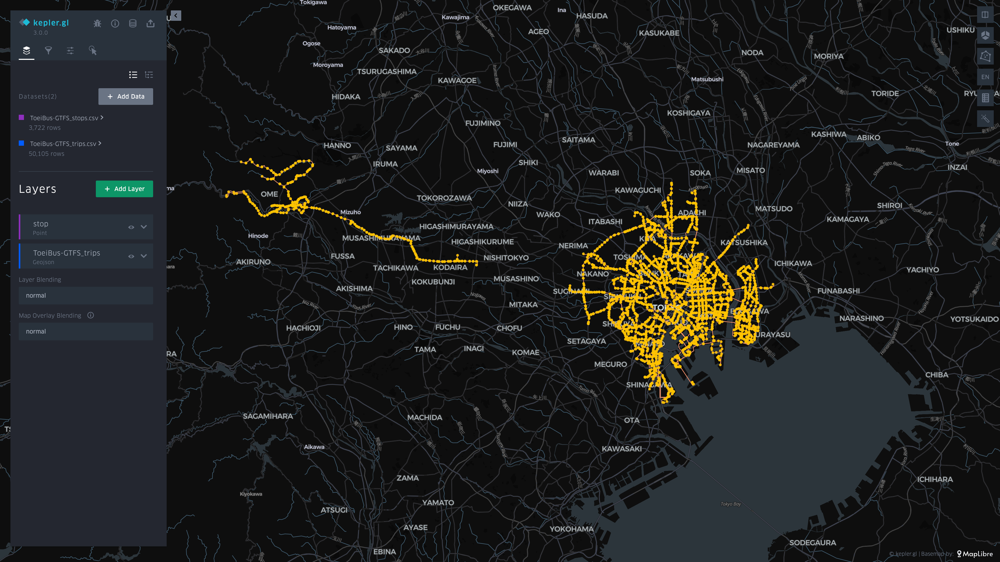


---

バス停名なども保持されている
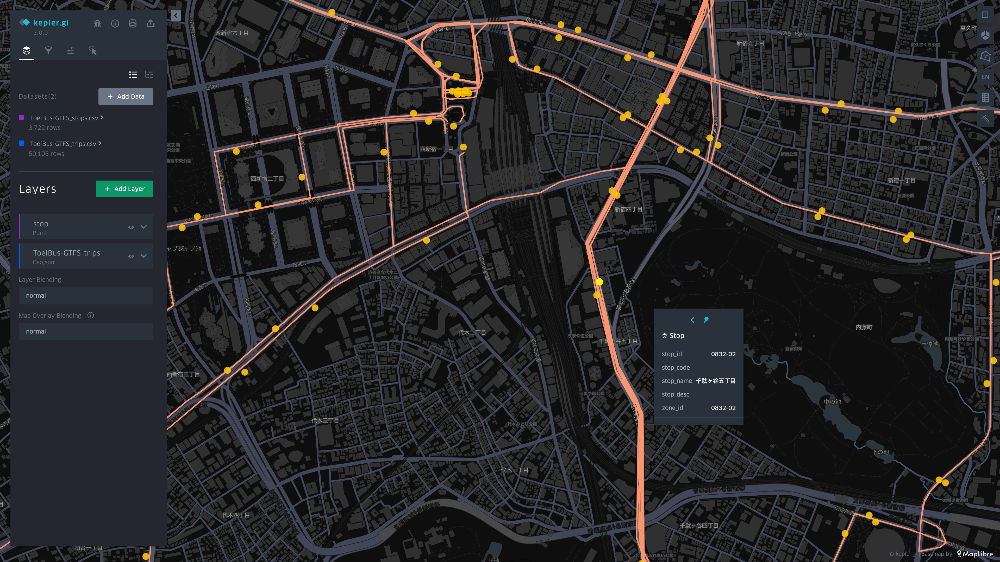

## あれ・・・？

- stops（標柱）を出すだけなら、DuckDBを使わずにそのままGTFSに含まれるstops.txtをKepler.glで表示できるのでは・・・？？
  - その通り！
- なぜDuckDBを使った？？
  - ただの可視化から先に進むため
  - e.g. とある場所から半径1km以内に存在する停留所を抽出する = SQL1行書けばOK（ST_BufferとST_Containsを使う）

## GTFS-RTをKepler.glで可視化してみる

- [Trip layer](https://docs.kepler.gl/docs/user-guides/c-types-of-layers/k-trip) という仕様でデータを出力すると、時系列の移動をアニメーションで表示できる
    - GeoJSONのLineStringにタイムスタンプを付与するちょっと変な仕様のため、普通のGISソフトだと上手く処理できない
    - DukDBなら頑張ってテンプレートさえ書ければ如何様にもできる

```sql
COPY (
    SELECT 'FeatureCollection' AS "type", LIST(feature) AS "features" FROM (
    SELECT 
    {
    "type": 'Feature',
    "properties": {"id": id},
    "geometry": {
        "type": 'LineString',
        "coordinates": array_agg(["vehicle.position.longitude", "vehicle.position.latitude", 0, epoch("vehicle.timestamp")] ORDER BY "vehicle.timestamp" ASC)
        } 
    -- WHERE句は必要に応じて調整してください
    }::JSON AS feature FROM toeibus.vehicles WHERE "vehicle.timestamp" > '2024-12-13 08:00:00' GROUP BY id)
) TO 'trip.json' (FORMAT JSON);
```

---

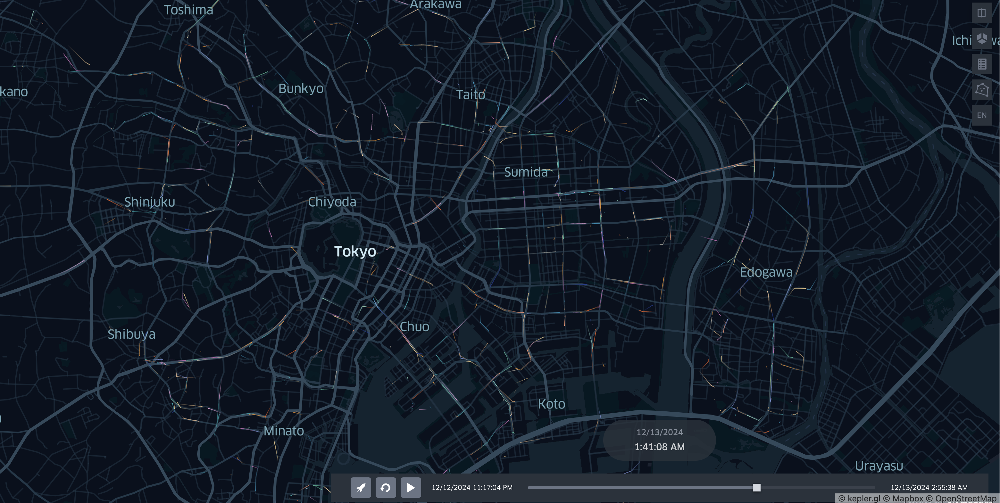


## 応用: JR貨物GTFSから物流の大動脈を探ってみる

- （タイトルは若干煽り）
- 運行頻度図に近しいものを作ってみる
    - 本来運行頻度図は駅間・バス停間の頻度を出すものなので途中停車が全て含まれているGTFSを用いて出力するが、
    JR貨物のGTFSは途中駅が入っているが走行線区がオーバーラップしていても停車駅が異なるケースがある為、
    Shapesの軌跡（From-To）が同じものをカウントすることで、どの線区がよく走行されているかを出してみた

---

```sql
-- Shapesを元に運行頻度を出してみる
USE gtfs.jrf;
COPY (
    WITH shape_segments AS (
        SELECT 
            s1.shape_id,
            s1.shape_pt_sequence AS from_seq,
            s1.shape_pt_lon AS from_lon,
            s1.shape_pt_lat AS from_lat,
            s2.shape_pt_sequence AS from_seq2,
            s2.shape_pt_lon AS to_lon,
            s2.shape_pt_lat AS to_lat
        FROM 
            shapes s1
        JOIN 
            shapes s2 ON s1.shape_id = s2.shape_id AND s1.shape_pt_sequence = s2.shape_pt_sequence - 1
    )
    SELECT count(shape_id), from_lon, from_lat, to_lon, to_lat
    FROM shape_segments
    GROUP BY from_lon, from_lat, to_lon, to_lat
) TO 'frequency.csv' WITH (FORMAT CSV, HEADER);
```

---

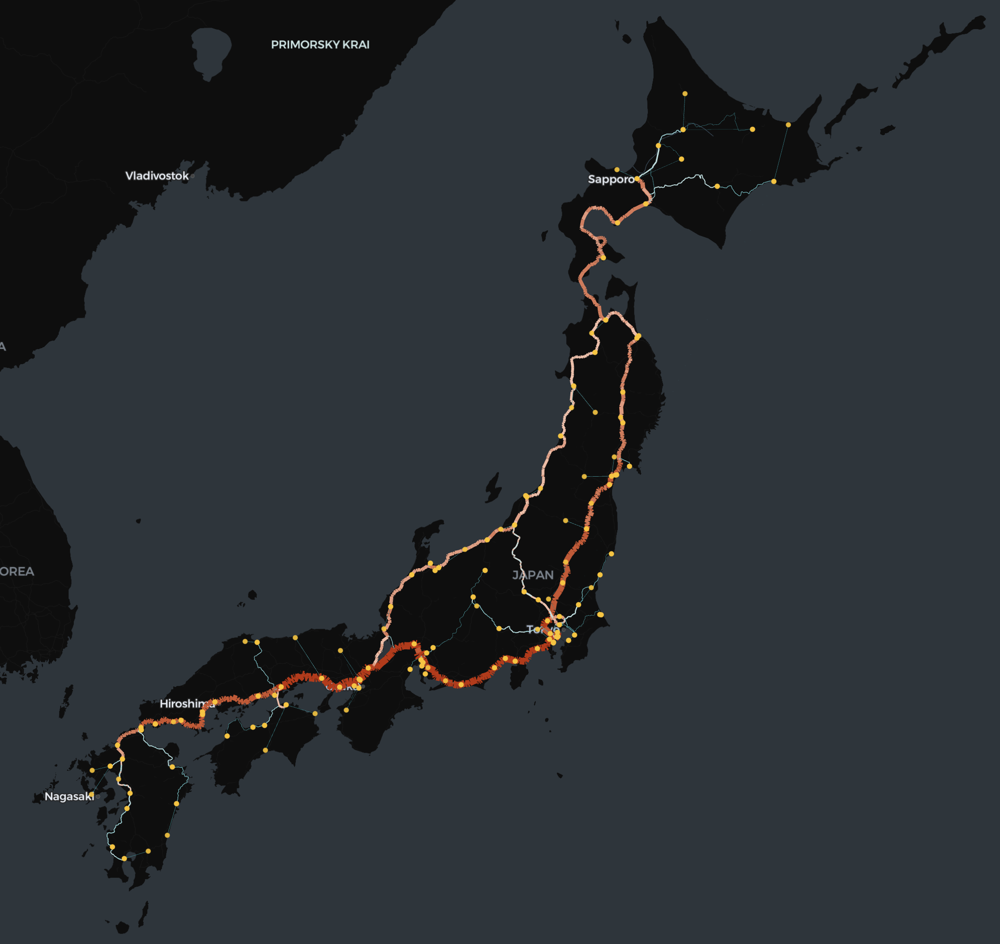

# ちょっと複雑な例

## 地価公示データと組み合わせてみる

- [国土数値情報::地価公示データ](https://nlftp.mlit.go.jp/ksj/gml/datalist/KsjTmplt-L01-2024.html)
- 点データを処理するときは[H3](https://h3geo.org)に変換して可視化することをお勧めします（軽い&後でアグリゲートしやすい）

```sql
INSTALL h3 FROM community;
LOAD h3;
INSTALL spatial;
load spatial;

CREATE TABLE land_price AS SELECT * FROM ST_Read('L01-24.geojson');
COPY (SELECT L01_008, h3_latlng_to_cell_string(ST_Y(geom), ST_X(geom), 9) FROM land_price) TO 'land_price.csv' (HEADER, DELIMITER ',');
```

## 地価公示データから都内で最も高級な都バスのバス停を探す
- 何となく予想が付くのであまり面白く無いかもだが・・・
- 公示価格データの代表点のみを使っているのでマッチしないバス停がある
- 厳密には公示価格データのポリゴンを作ってそれにマッチさせる必要がある

```sql
-- gtfs.duckdb を'gtfs'としてアタッチ
ATTACH 'gtfs.duckdb' AS gtfs (READ_ONLY);

COPY (
    SELECT h3_latlng_to_cell_string(stop_lat, stop_lon, 9), stop_name, lp.price FROM gtfs.toeibus.stops
    -- 都バスGTFSのstopsと地価公示データのPointをそれぞれH3に変換して公示価格をstopsに対してJOIN
    LEFT JOIN (SELECT L01_008 AS price, h3_latlng_to_cell_string(ST_Y(geom), ST_X(geom), 9) AS h3 FROM land_price) AS lp
    ON h3_latlng_to_cell_string(stop_lat, stop_lon, 9) = lp.h3
    ORDER BY lp.price DESC
) TO 'pole_price.csv' (HEADER, DELIMITER ',');
```

---

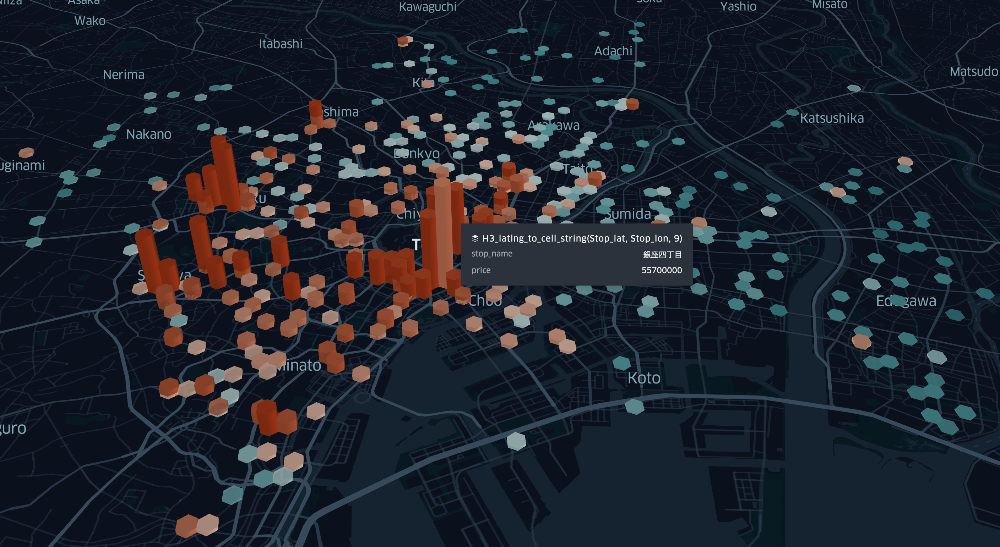

## 国勢調査と組み合わせてみる

- [e-Stat統計地理情報システム](https://www.e-stat.go.jp/gis)から国勢調査の結果を取得する
    - GIS処理しやすいように加工されたデータが提供されている
- 東京都が含まれる[M5339の5次メッシュShapeデータ](https://www.e-stat.go.jp/gis/statmap-search/data?dlserveyId=Q&code=5339&coordSys=1&format=shape&downloadType=5)をダウンロードする
    - １次メッシュ枠情報: https://www.e-stat.go.jp/pdf/gis/primary_mesh_jouhou.pdf 
- ダウンロードしてきたファイルを解凍し、DuckDBに読み込む
```bash
$ unzip QDDSWQ5339.zip
$ duckdb ViewGTFS.duckdb
v1.0.0 1f98600c2c
Enter ".help" for usage hints.
D load spatial;
D CREATE OR REPLACE TABLE mesh_5th AS SELECT * FROM ST_Read('MESH05339.shp');
```

---

- 東京都が含まれる[M5339の5次メッシュ国勢調査結果データ](https://www.e-stat.go.jp/gis/statmap-search/data?statsId=T001142&code=5339&downloadType=2)をダウンロードする
- ダウンロードしてきたファイルを解凍し、文字コードをCP932(ShiftJIS)からUTF-8に変換する（しなくてもなんとかなるが、なんとなく気持ち悪いので変換する）
```bash
$ unzip -p tblT001142Q5339.zip | iconv -c -f cp932 -t utf-8 > tblT001142Q5339_utf8.txt
```
- 変換したデータをDuckDBに読み込む
```bash
$ duckdb ViewGTFS.duckdb
v1.0.0 1f98600c2c
Enter ".help" for usage hints.
D load spatial;
-- 2行の日本語ヘッダーがレコードとして含まれているが気にしない
D CREATE OR REPLACE TABLE census AS SELECT * FROM read_csv('tblT001142Q5339_utf8.txt', header = true);
```
- メッシュコードをJOINしてGeoJSON::ポリゴンとして保存する
```SQL
-- メッシュ内総人口はT001142001カラムに保存されているので、メッシュコードのポリゴンと人口をJOINしてGeoJSONとして保存する
D COPY (
    SELECT mesh_5th.KEY_CODE, census.T001142001 AS population, geom FROM mesh_5th 
    LEFT JOIN census ON mesh_5th.KEY_CODE = census.KEY_CODE
) TO 'census.geojson' WITH (FORMAT GDAL, DRIVER 'GeoJSON', LAYER_CREATION_OPTIONS 'WRITE_BBOX=YES');
```

---

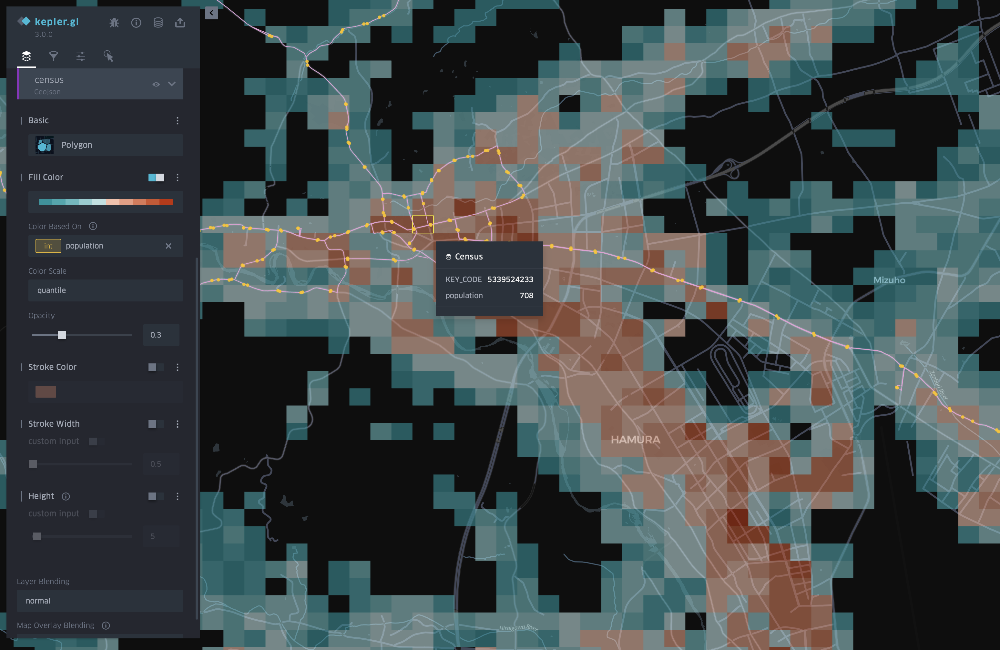

## 経路探索と組み合わせてみる

- GTFSを読み込んで、経路探索を行うツールを使う
    - [OpenTripPlanner](https://opentripplanner.org)
    - [GraphHopper](https://www.graphhopper.com)
    - [Valhalla](https://valhalla.readthedocs.io)（できるっぽいが、特定のレジストリに依存するらしく自由に読み込ませる方法が不明）
- [@takoyaki3333333](https://x.com/takoyaki3333333) が[OpenTripPlannerを使ったサンプル](https://github.com/takoyaki-3/odpt-challenge2024-jre-otp-docker)を公開
- 経路探索エンジンを使うと何ができる？
    - 経路案内: 但し乗換所要時間などが精緻でないので、ナビゲーションとして使うには要注意
    - 経路推定: 乗車券が時刻t1にAバス停からBバス停で使われた場合に乗車したバス路線の推定
    - 等時線(Isochrone)分析: 特定の出発地点からある時間で到達可能な範囲を示したもの

---
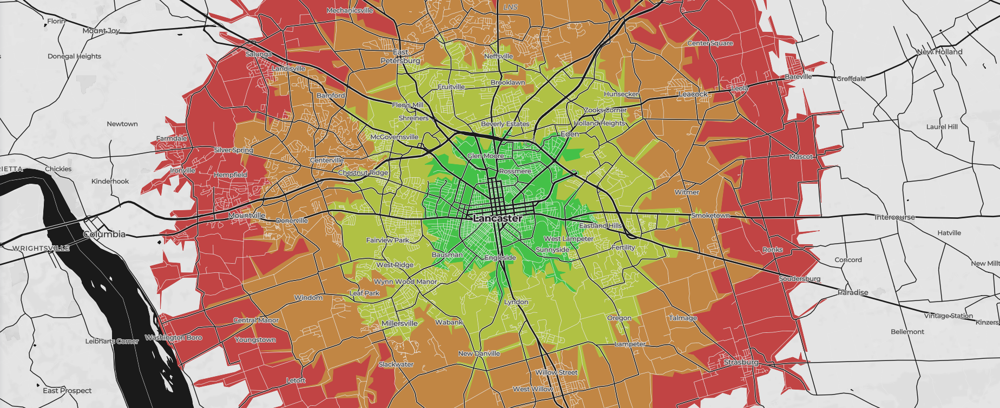

## まとめ

- GTFSをDuckDBに読み込んでKepler.glで可視化する方法を紹介
- 可視化はデータ活用の第一歩
    - 可視化をすることで、データを直感的かつ俯瞰的に見ることができる
    - 可視化をするためにデータを処理することで、応用ができるようになる
- 様々なデータを組み合わせることで、新たな価値が生まれる？！
    - 組み合わせる為には、対象データの「空間」を揃える必要がある
        - 今回は地理空間に揃えた
        - 他に時間軸、属性軸なども考えられる
    - このような処理を行う際、DuckDBはお手軽で非常に強力なツール
    - 今後の為にもSQLは使えるとヨシッ！

::: {style="font-size: 3em; color: red;"}
Let's データ利活用！
:::


## Appendix: ツール・サービス紹介

::: {style="font-size: 0.6em;"}
- [DuckDB](https://duckdb.org): ローカルOLAP環境、GISデータも扱える、今後のデータ処理におけるデファクトはこれだと思ってる
- [Kepler.gl](https://kepler.gl/): Uberが開発したWebGLを使った高速な地理情報可視化環境

- [OpenTripPlanner](https://opentripplanner.org): オープンソースの経路探索エンジン、GTFSを読み込んで経路探索ができる
- [Valhalla](https://github.com/valhalla/valhalla): Mapzenが開発した経路探索エンジン、OSMのデータを使って経路探索できる
- [GraphHopper](https://www.graphhopper.com): 歴史ある経路探索エンジン、GTFSを読み込んで経路探索ができる
- [gtfs-realtime-bindings](https://github.com/MobilityData/gtfs-realtime-bindings): GTFS-RTを扱う時に使うライブラリ、これがデファクトだと思う（方法はいっぱいあるけど）

- [Visual Studio Code](https://code.visualstudio.com/): Microsoftが開発した軽量なIDE、PythonやSQLの開発にも使える、最早デファクトエディタ（エディタ戦争の終焉）
- [Jupyter Lab](https://jupyter.org/): Pythonのインタラクティブな開発環境、データ分析にはよく使われる
- [Quarto](https://quarto.org/): Markdownで記述したドキュメントを、PDFやHTML、docxに出力できる。内部でPandocを使用。このプレゼンもQuarto製、TeXの時代は終わったのかもしれない・・・
- [uv](https://github.com/astral-sh/uv): Rustで実装された、Pythonパッケージ管理システム。最近venv環境構築にも対応したのでpipenvから乗り換えた（脱Lock地獄）
- [Polars](https://pola.rs): Rustで実装された高速なデータフレームライブラリ、PythonのPandasと互換性がある
- [GeoPandas](https://geopandas.org): Pandasの拡張で、GISデータを扱うためのライブラリ
- [deck.gl](https://deck.gl/): Uberが開発したWebGLを使った高速な地理情報可視化ライブラリ、Python Bindingもある
- [Pandas](https://pandas.pydata.org/): Pythonのデータフレームライブラリ、ど定番。
- [Dusk](https://dask.org): Pythonの分散処理ライブラリ、Pandasで処理を書いてしまいデータが大きすぎて処理できない場合の救世主
- [dbt](https://www.getdbt.com): ETLツール、SQLでデータ変換を記述できる
- [dlt](https://dlthub.com): Data Load Tool、データロードを管理するためのツール

- [Apache Superset](https://superset.apache.org/): Airbnbが開発したBIツール、OSSのBIツールの中ではGISデータの扱いが比較的得意
- [Forsquare Studio](https://studio.foursquare.com): Kepler.glの高機能版
- [Databricks](https://databricks.com): Apache Sparkをベースにしたクラウド型データ基盤、データ分析環境。DuckDBで管理しきれなくなったらこちらに移行検討を（最初から検討した方がいいケースもあり）
:::
